# **Stock Market Analysis for Technology Corporations in 2019**

In [1]:
# import basic libraries
import pandas as pd
from pandas import Series, DataFrame
import numpy as np
import scipy.stats as stats
from warnings import filterwarnings

# import data reader
from pandas_datareader import data, wb
import pandas_datareader.data as web

# import time stamps library
from datetime import datetime

# import visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# give white grid bacground
sns.set_style('whitegrid')

In [2]:
# AAPL = Apple, GOOG = Google, MSFT = Microsoft, AMZN = Amazon, INTC = Intel
tech_corp = ['AAPL', 'GOOG', 'MSFT', 'AMZN', 'INTC']

In [3]:
# set the starting date (1 January 2019) and ending date (31 December 2019) of the analysis
end = datetime(year = 2019, month = 12, day = 31)

start = datetime(end.year, month = 1, day = 1)

In [4]:
# fetching the data from yahoo
for stock in tech_corp:
    globals()[stock] = web.DataReader(stock, 'yahoo', start, end)

## Data Overview for Each Technology Corporation

In [5]:
# description of Apple stock
AAPL.describe()

,High,Low,Open,Close,Volume,Adj Close
count,253.000000,253.000000,253.000000,253.000000,2.530000e+02,253.000000
mean,209.632214,206.074822,207.674071,208.056284,2.805852e+07,205.395530
std,34.562977,34.380412,34.445268,34.616376,1.081148e+07,35.029156
min,145.720001,142.000000,143.979996,142.190002,1.136200e+07,139.125412
25%,187.330002,182.850006,184.850006,185.720001,2.099050e+07,182.889603
50%,204.490005,201.559998,203.119995,202.899994,2.588170e+07,200.321732
75%,224.580002,220.789993,223.059998,223.589996,3.204650e+07,221.393372
max,293.970001,289.519989,291.119995,293.649994,9.131220e+07,291.638000


In [6]:
# column information of Apple stock
AAPL.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 253 entries, 2018-12-31 to 2019-12-31
Data columns (total 6 columns):
High         253 non-null float64
Low          253 non-null float64
Open         253 non-null float64
Close        253 non-null float64
Volume       253 non-null float64
Adj Close    253 non-null float64
dtypes: float64(6)
memory usage: 13.8 KB


In [7]:
# description of Google stock
GOOG.describe()

,High,Low,Open,Close,Volume,Adj Close
count,253.000000,253.000000,253.000000,253.000000,2.530000e+02,253.000000
mean,1196.218083,1177.911348,1186.472075,1187.789172,1.414398e+06,1187.789172
std,81.453658,83.233628,81.857883,82.166363,6.212790e+05,82.166363
min,1047.489990,1014.070007,1016.570007,1016.059998,3.475000e+05,1016.059998
25%,1129.099976,1111.209961,1119.989990,1121.369995,1.065700e+06,1121.369995
50%,1194.079956,1171.810059,1182.829956,1184.619995,1.301400e+06,1184.619995
75%,1246.739990,1227.819946,1235.989990,1239.560059,1.538200e+06,1239.560059
max,1365.000000,1352.670044,1363.349976,1361.170044,6.207000e+06,1361.170044


In [8]:
# column information of Google stock
GOOG.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 253 entries, 2018-12-31 to 2019-12-31
Data columns (total 6 columns):
High         253 non-null float64
Low          253 non-null float64
Open         253 non-null float64
Close        253 non-null float64
Volume       253 non-null int64
Adj Close    253 non-null float64
dtypes: float64(5), int64(1)
memory usage: 13.8 KB


In [9]:
# description of Microsoft stock
MSFT.describe()

,High,Low,Open,Close,Volume,Adj Close
count,253.000000,253.000000,253.000000,253.000000,2.530000e+02,253.000000
mean,131.116996,129.189763,130.224230,130.268142,2.461674e+07,128.401116
std,15.007349,15.024365,15.076573,14.980826,7.705994e+06,15.279697
min,100.190002,97.199997,99.550003,97.400002,8.989200e+06,95.223351
25%,119.589996,118.379997,119.059998,119.279999,1.841280e+07,117.112396
50%,135.929993,133.570007,134.949997,135.160004,2.375060e+07,133.195053
75%,140.360001,138.250000,139.660004,139.139999,2.843710e+07,137.534241
max,159.550003,158.220001,159.449997,158.960007,5.563640e+07,157.705505


In [10]:
# column information of Microsoft stock
MSFT.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 253 entries, 2018-12-31 to 2019-12-31
Data columns (total 6 columns):
High         253 non-null float64
Low          253 non-null float64
Open         253 non-null float64
Close        253 non-null float64
Volume       253 non-null float64
Adj Close    253 non-null float64
dtypes: float64(6)
memory usage: 13.8 KB


In [11]:
# description of Amazon stock
AMZN.describe()

,High,Low,Open,Close,Volume,Adj Close
count,253.000000,253.000000,253.000000,253.000000,2.530000e+02,253.000000
mean,1801.476128,1771.986403,1787.647588,1788.053952,3.880174e+06,1788.053952
std,101.892120,104.414193,104.204117,102.712173,1.622495e+06,102.712173
min,1520.760010,1460.930054,1465.199951,1500.280029,8.813000e+05,1500.280029
25%,1746.869995,1715.250000,1731.630005,1735.650024,2.781200e+06,1735.650024
50%,1798.199951,1773.359985,1788.260010,1786.400024,3.483400e+06,1786.400024
75%,1867.780029,1835.540039,1848.400024,1855.319946,4.640400e+06,1855.319946
max,2035.800049,2003.869995,2025.619995,2020.989990,1.150620e+07,2020.989990


In [12]:
# column information of Amazon stock
AMZN.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 253 entries, 2018-12-31 to 2019-12-31
Data columns (total 6 columns):
High         253 non-null float64
Low          253 non-null float64
Open         253 non-null float64
Close        253 non-null float64
Volume       253 non-null int64
Adj Close    253 non-null float64
dtypes: float64(5), int64(1)
memory usage: 13.8 KB


In [13]:
# description of Intel stock
INTC.describe()

,High,Low,Open,Close,Volume,Adj Close
count,253.000000,253.000000,253.000000,253.000000,2.530000e+02,253.000000
mean,51.798380,50.850118,51.300830,51.357628,2.189940e+07,49.918972
std,4.326067,4.392044,4.364993,4.380942,9.623841e+06,4.417352
min,44.459999,42.860001,43.349998,43.459999,6.313200e+06,42.195328
25%,48.000000,47.040001,47.560001,47.540001,1.632010e+07,46.087029
50%,51.669998,50.560001,51.080002,51.040001,1.915450e+07,49.729515
75%,54.799999,54.000000,54.419998,54.509998,2.552230e+07,52.601627
max,60.480000,59.900002,59.990002,60.080002,8.645570e+07,59.048733


In [14]:
# column information of Intel stock
INTC.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 253 entries, 2018-12-31 to 2019-12-31
Data columns (total 6 columns):
High         253 non-null float64
Low          253 non-null float64
Open         253 non-null float64
Close        253 non-null float64
Volume       253 non-null float64
Adj Close    253 non-null float64
dtypes: float64(6)
memory usage: 13.8 KB


### The Change in Price of the Stock Over Time

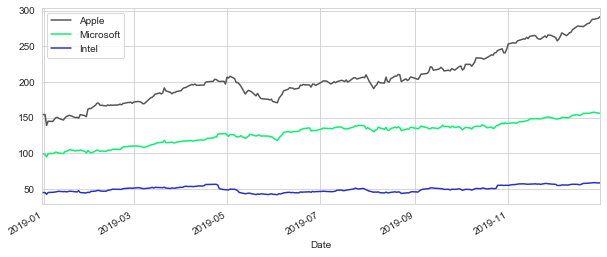

In [15]:
# plot of adjusted close price of technology corporations
AAPL['Adj Close'].plot(legend = True, figsize = (10, 4), label = 'Apple', color = '#555555')
MSFT['Adj Close'].plot(legend = True, figsize = (10, 4), label = 'Microsoft', color = '#08F26E')
INTC['Adj Close'].plot(legend = True, figsize = (10, 4), label = 'Intel', color = '#2832C2')

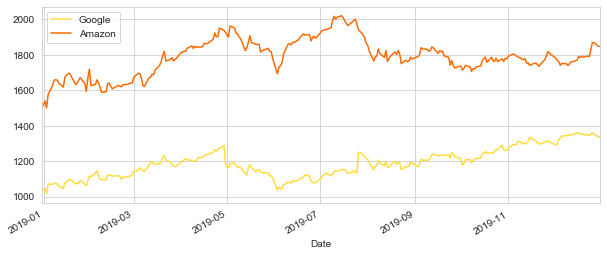

In [16]:
GOOG['Adj Close'].plot(legend = True, figsize = (10, 4), label = 'Google', color = '#FFDD3C')
AMZN['Adj Close'].plot(legend = True, figsize = (10, 4), label = 'Amazon', color = '#FD6A02')

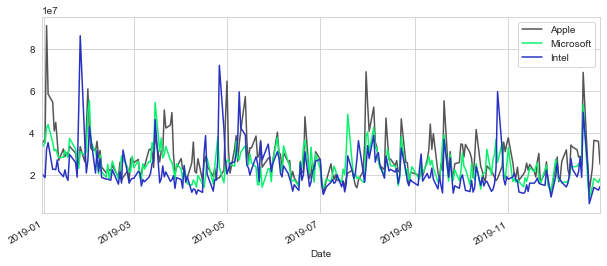

In [17]:
# plot of volume traded in each technology corporation
AAPL['Volume'].plot(legend = True, figsize = (10, 4), label = 'Apple', color = '#555555')
MSFT['Volume'].plot(legend = True, figsize = (10, 4), label = 'Microsoft', color = '#08F26E')
INTC['Volume'].plot(legend = True, figsize = (10, 4), label = 'Intel', color = '#2832C2')

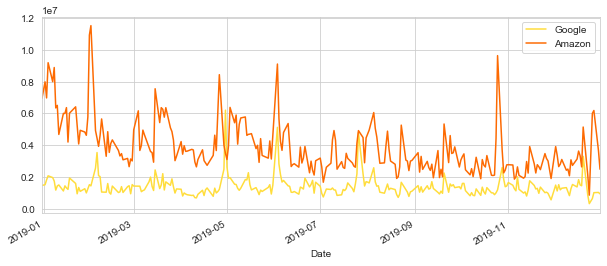

In [18]:
GOOG['Volume'].plot(legend = True, figsize = (10, 4), label = 'Google', color = '#FFDD3C')
AMZN['Volume'].plot(legend = True, figsize = (10, 4), label = 'Amazon', color = '#FD6A02')

In order to visualize the graphs better, Google and Amazon are separated from Apple, Microsoft, and Intel because the groups have significant amount of average price level for both adjusted closing price and volume of trade.

It can be seen that both Google and Amazon have low volume of stocks traded as they have high stock price on average. On the other hand, Apple, Microsoft and Intel have high volume due to lower stock price in comparison to Google and Amazon.

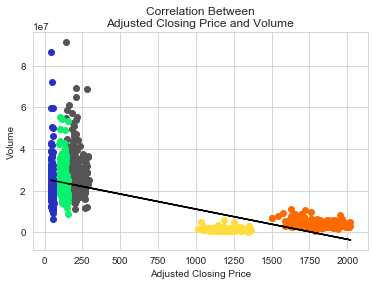

In [19]:
# data frame for adjusted closing price and volume
adj_close_df = pd.concat([AAPL['Adj Close'], GOOG['Adj Close'], MSFT['Adj Close'], AMZN['Adj Close'], INTC['Adj Close']])
volume_df = pd.concat([AAPL['Volume'], GOOG['Volume'], MSFT['Volume'], AMZN['Volume'], INTC['Volume']])

# scatterplot
plt.scatter(x = AAPL['Adj Close'], y = AAPL['Volume'], color = '#555555')
plt.scatter(x = GOOG['Adj Close'], y = GOOG['Volume'], color = '#FFDD3C')
plt.scatter(x = MSFT['Adj Close'], y = MSFT['Volume'], color = '#08F26E')
plt.scatter(x = AMZN['Adj Close'], y = AMZN['Volume'], color = '#FD6A02')
plt.scatter(x = INTC['Adj Close'], y = INTC['Volume'], color = '#2832C2')

# labeling
plt.xlabel('Adjusted Closing Price')
plt.ylabel('Volume')
plt.title('Correlation Between\nAdjusted Closing Price and Volume')

# trendline
adj_vol_fit = np.polyfit(adj_close_df, volume_df, 1)
adj_vol_polinom = np.poly1d(adj_vol_fit)
plt.plot(adj_close_df, adj_vol_polinom(adj_close_df), 'k-')

According to the scatterplot, there is a negative correlation between Adjusted Closing Price and Volume.

### The Moving Average of the Various Stocks

In [20]:
# calculating moving average
ma_day = [10, 20, 50]

for ma in ma_day:
    column_name = "MA for %s days" %(str(ma))
    
    AAPL[column_name] = DataFrame.rolling(AAPL['Adj Close'], ma).mean()
    GOOG[column_name] = DataFrame.rolling(GOOG['Adj Close'], ma).mean()
    MSFT[column_name] = DataFrame.rolling(MSFT['Adj Close'], ma).mean()
    AMZN[column_name] = DataFrame.rolling(AMZN['Adj Close'], ma).mean()
    INTC[column_name] = DataFrame.rolling(INTC['Adj Close'], ma).mean()

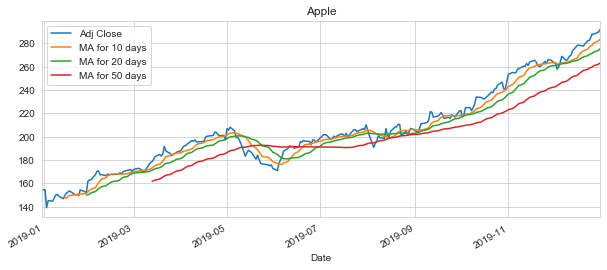

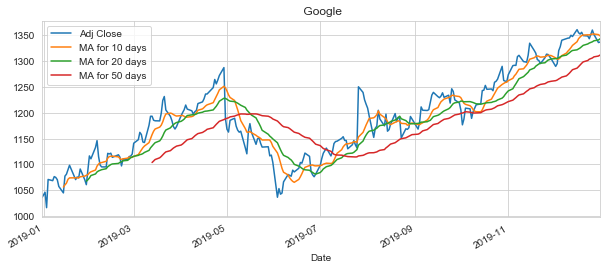

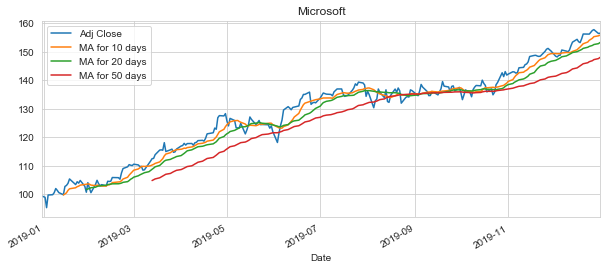

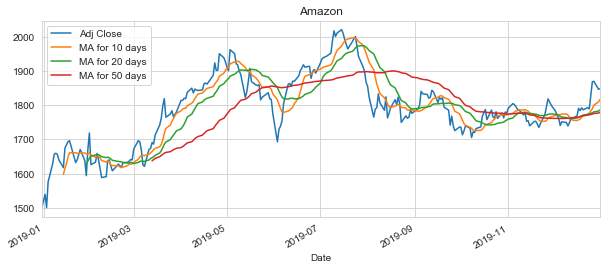

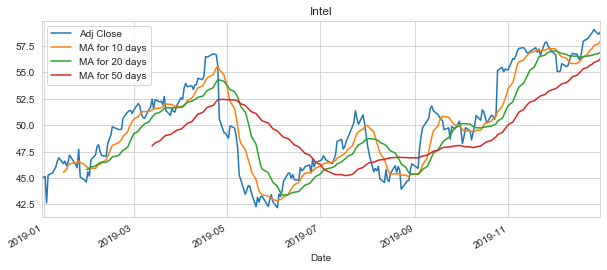

In [21]:
# plot the moving average
AAPL[['Adj Close', 'MA for 10 days', 'MA for 20 days', 'MA for 50 days']].plot(subplots = False, figsize = (10, 4), title = 'Apple')
GOOG[['Adj Close', 'MA for 10 days', 'MA for 20 days', 'MA for 50 days']].plot(subplots = False, figsize = (10, 4), title = ' Google')
MSFT[['Adj Close', 'MA for 10 days', 'MA for 20 days', 'MA for 50 days']].plot(subplots = False, figsize = (10, 4), title = 'Microsoft')
AMZN[['Adj Close', 'MA for 10 days', 'MA for 20 days', 'MA for 50 days']].plot(subplots = False, figsize = (10, 4), title = 'Amazon')
INTC[['Adj Close', 'MA for 10 days', 'MA for 20 days', 'MA for 50 days']].plot(subplots = False, figsize = (10, 4), title = 'Intel')

### The Daily Return of the Stock on Average

In [22]:
# creating percentage change
AAPL['Daily Return'] = AAPL['Adj Close'].pct_change()
GOOG['Daily Return'] = GOOG['Adj Close'].pct_change()
MSFT['Daily Return'] = MSFT['Adj Close'].pct_change()
AMZN['Daily Return'] = AMZN['Adj Close'].pct_change()
INTC['Daily Return'] = INTC['Adj Close'].pct_change()

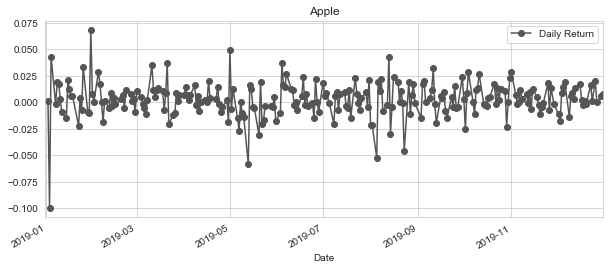

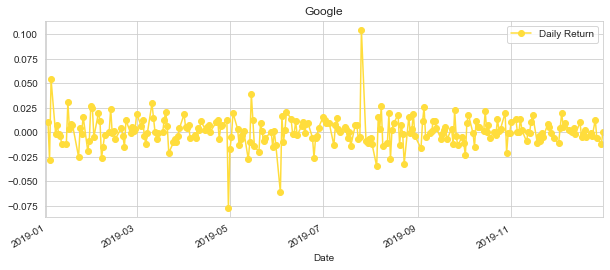

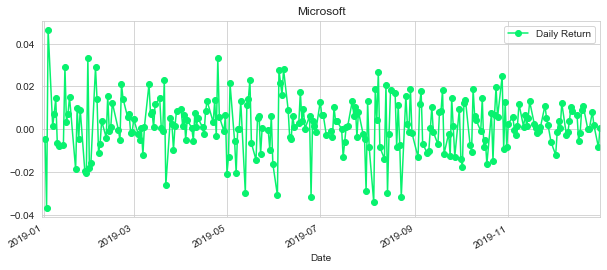

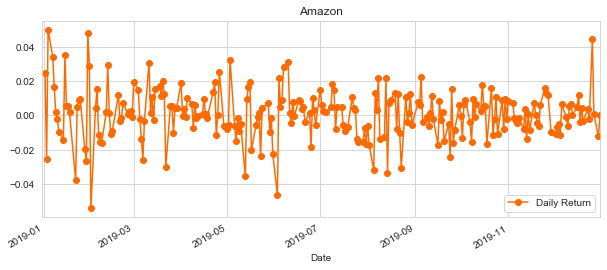

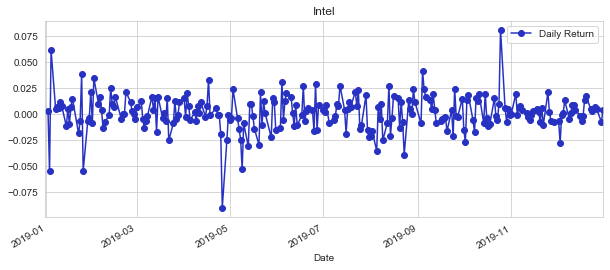

In [23]:
# plotting the daily return stock in percentage change
AAPL[['Daily Return']].plot(
    subplots = False, 
    figsize = (10, 4), 
    legend = True, 
    linestyle = '-', 
    marker = 'o', 
    color = '#555555',
    title = 'Apple'
)

GOOG[['Daily Return']].plot(
    subplots = False, 
    figsize = (10, 4), 
    legend = True, 
    linestyle = '-', 
    marker = 'o', 
    color = '#FFDD3C',
    title = 'Google'
)

MSFT[['Daily Return']].plot(
    subplots = False, 
    figsize = (10, 4), 
    legend = True, 
    linestyle = '-', 
    marker = 'o', 
    color = '#08F26E',
    title = 'Microsoft'
)

AMZN[['Daily Return']].plot(
    subplots = False, 
    figsize = (10, 4), 
    legend = True, 
    linestyle = '-', 
    marker = 'o', 
    color = '#FD6A02',
    title = 'Amazon'
)
INTC[['Daily Return']].plot(
    subplots = False, 
    figsize = (10, 4), 
    legend = True, 
    linestyle = '-', 
    marker = 'o', 
    color = '#2832C2',
    title = 'Intel'
)

In [24]:
AAPL_copy = AAPL.copy()
AAPL_copy = AAPL_copy.rename(columns={'High': 'AAPL High', 
                          'Low': 'AAPL Low',
                          'Open': 'AAPL Open',
                          'Close': 'AAPL Close',
                          'Volume': 'AAPL Volume',
                          'Adj Close': 'AAPL Adj Close',
                          'MA for 10 days': 'AAPL MA for 10 days',
                          'MA for 20 days': 'AAPL MA for 20 days',
                          'MA for 50 days': 'AAPL MA for 50 days',
                          'Daily Return': 'AAPL Daily Return'
                         })

GOOG_copy = GOOG.copy()
GOOG_copy = GOOG_copy.rename(columns={'High': 'GOOG High', 
                          'Low': 'GOOG Low',
                          'Open': 'GOOG Open',
                          'Close': 'GOOG Close',
                          'Volume': 'GOOG Volume',
                          'Adj Close': 'GOOG Adj Close',
                          'MA for 10 days': 'GOOG MA for 10 days',
                          'MA for 20 days': 'GOOG MA for 20 days',
                          'MA for 50 days': 'GOOG MA for 50 days',
                          'Daily Return': 'GOOG Daily Return'
                         })

MSFT_copy = MSFT.copy()
MSFT_copy = MSFT_copy.rename(columns={'High': 'MSFT High', 
                          'Low': 'MSFT Low',
                          'Open': 'MSFT Open',
                          'Close': 'MSFT Close',
                          'Volume': 'MSFT Volume',
                          'Adj Close': 'MSFT Adj Close',
                          'MA for 10 days': 'MSFT MA for 10 days',
                          'MA for 20 days': 'MSFT MA for 20 days',
                          'MA for 50 days': 'MSFT MA for 50 days',
                          'Daily Return': 'MSFT Daily Return'
                         })

AMZN_copy = AMZN.copy()
AMZN_copy = AMZN_copy.rename(columns={'High': 'AMZN High', 
                          'Low': 'AMZN Low',
                          'Open': 'AMZN Open',
                          'Close': 'AMZN Close',
                          'Volume': 'AMZN Volume',
                          'Adj Close': 'AMZN Adj Close',
                          'MA for 10 days': 'AMZN MA for 10 days',
                          'MA for 20 days': 'AMZN MA for 20 days',
                          'MA for 50 days': 'AMZN MA for 50 days',
                          'Daily Return': 'AMZN Daily Return'
                         })

INTC_copy = INTC.copy()
INTC_copy = INTC_copy.rename(columns={'High': 'INTC High', 
                          'Low': 'INTC Low',
                          'Open': 'INTC Open',
                          'Close': 'INTC Close',
                          'Volume': 'INTC Volume',
                          'Adj Close': 'INTC Adj Close',
                          'MA for 10 days': 'INTC MA for 10 days',
                          'MA for 20 days': 'INTC MA for 20 days',
                          'MA for 50 days': 'INTC MA for 50 days',
                          'Daily Return': 'INTC Daily Return'
                         })

In [25]:
tech_corp_concat = pd.concat([AAPL_copy, GOOG_copy, MSFT_copy, AMZN_copy, INTC_copy], axis=1)
tech_corp_concat.head()

,AAPL High,AAPL Low,AAPL Open,AAPL Close,AAPL Volume,AAPL Adj Close,AAPL MA for 10 days,AAPL MA for 20 days,AAPL MA for 50 days,AAPL Daily Return,...,INTC High,INTC Low,INTC Open,INTC Close,INTC Volume,INTC Adj Close,INTC MA for 10 days,INTC MA for 20 days,INTC MA for 50 days,INTC Daily Return
Date,,,,,,,,,,,,,,,,,,,,,
2018-12-31,159.360001,156.479996,158.529999,157.740005,35003500.0,154.340271,NaN,NaN,NaN,NaN,...,47.480000,46.549999,47.090000,46.930000,20490400.0,45.001755,NaN,NaN,NaN,NaN
2019-01-02,158.850006,154.229996,154.889999,157.919998,37039700.0,154.516388,NaN,NaN,NaN,0.001141,...,47.470001,45.770000,45.959999,47.080002,18774600.0,45.145596,NaN,NaN,NaN,0.003196
2019-01-03,145.720001,142.000000,143.979996,142.190002,91312200.0,139.125412,NaN,NaN,NaN,-0.099607,...,46.279999,44.389999,46.150002,44.490002,32267300.0,42.662006,NaN,NaN,NaN,-0.055013
2019-01-04,148.550003,143.800003,144.529999,148.259995,58607100.0,145.064575,NaN,NaN,NaN,0.042689,...,47.570000,45.540001,45.840000,47.220001,35447300.0,45.279839,NaN,NaN,NaN,0.061362
2019-01-07,148.830002,145.899994,148.699997,147.929993,54777800.0,144.741714,NaN,NaN,NaN,-0.002226,...,48.000000,46.750000,47.099998,47.439999,22736800.0,45.490799,NaN,NaN,NaN,0.004659


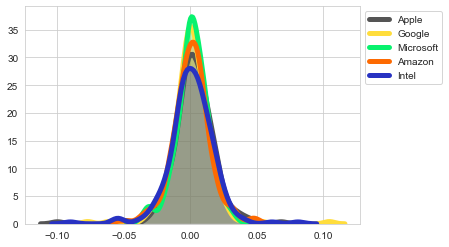

In [26]:
# plotting the daily return stock on average
sns.distplot(
    AAPL[['Daily Return']].dropna(), 
    hist = False,
    kde = True,
    kde_kws = {'linewidth': 5,
               'shade': True
              }, 
    color = '#555555',
    label = 'Apple'
)
sns.distplot(
    GOOG[['Daily Return']].dropna(), 
    hist = False,
    kde = True,
    kde_kws = {'linewidth': 5,
               'shade': True
              },
    color = '#FFDD3C',
    label = 'Google'
)
sns.distplot(
    MSFT[['Daily Return']].dropna(), 
    hist = False,
    kde = True,
    kde_kws = {'linewidth': 5,
               'shade': True
              },
    color = '#08F26E',
    label = 'Microsoft'
)
sns.distplot(
    AMZN[['Daily Return']].dropna(),               
    hist = False,
    kde = True,
    kde_kws = {'linewidth': 5,
               'shade': True
              },
    color = '#FD6A02', 
    label = 'Amazon'
)
sns.distplot(
    INTC[['Daily Return']].dropna(),                
    hist = False,
    kde = True,
    kde_kws = {'linewidth': 5,
               'shade': True
              },
    color = '#2832C2',
    label = 'Intel'
)

plt.legend(bbox_to_anchor = (1, 1), loc = 'upper left')
plt.rcParams["figure.figsize"] = (75,50)

D:\Applications\Anaconda\lib\site-packages\ipykernel_launcher.py:7: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  import sys


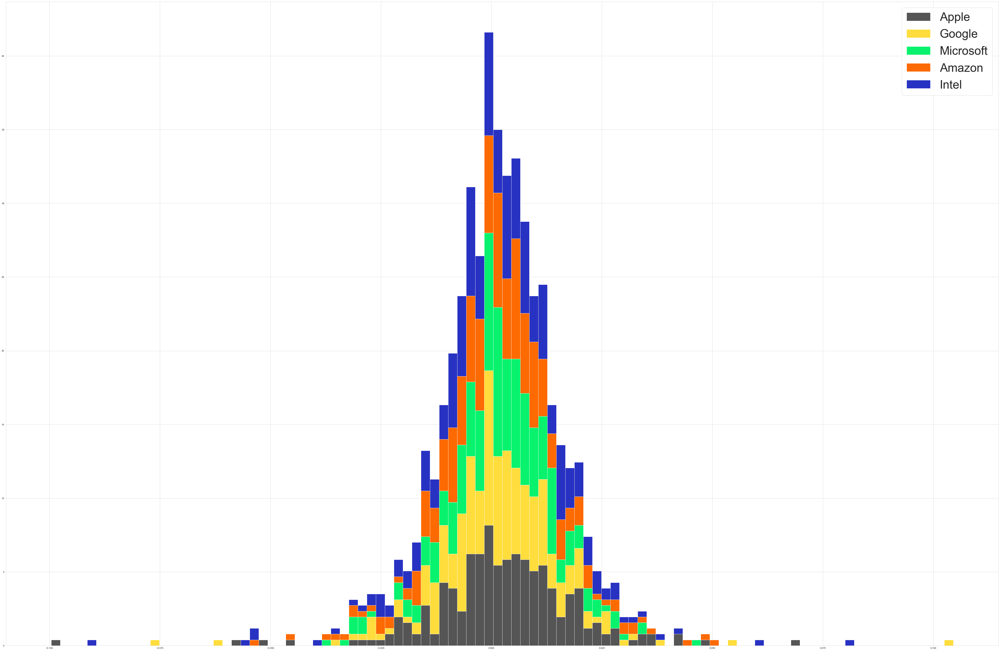

In [27]:
# plotting the daily return stock on average (histogram)
plt.hist([AAPL['Daily Return'], GOOG['Daily Return'], MSFT['Daily Return'], AMZN['Daily Return'], INTC['Daily Return']], 
         bins = 100,
         stacked = True,
         normed = True,
         color = ['#555555', '#FFDD3C', '#08F26E', '#FD6A02', '#2832C2'],
         label = ['Apple', 'Google', 'Microsoft', 'Amazon', 'Intel']
        )
plt.legend(prop={'size': 50})
plt.rcParams["figure.figsize"] = (60,30)

In [28]:
# getting only the daily return in each technology corporation list
closing = web.DataReader(tech_corp, 'yahoo', start, end)['Adj Close']
closing.head()

Symbols,AAPL,AMZN,GOOG,INTC,MSFT
Date,,,,,
2018-12-31,154.340271,1501.969971,1035.609985,45.001755,99.300156
2019-01-02,154.516388,1539.130005,1045.849976,45.145596,98.860214
2019-01-03,139.125412,1500.280029,1016.059998,42.662006,95.223351
2019-01-04,145.064575,1575.390015,1070.709961,45.279839,99.652115
2019-01-07,144.741714,1629.510010,1068.390015,45.490799,99.779205


In [29]:
# identifying the percentage change in daily returns
tech_returns = closing.pct_change()
tech_returns.head()

Symbols,AAPL,AMZN,GOOG,INTC,MSFT
Date,,,,,
2018-12-31,NaN,NaN,NaN,NaN,NaN
2019-01-02,0.001141,0.024741,0.009888,0.003196,-0.004430
2019-01-03,-0.099607,-0.025242,-0.028484,-0.055013,-0.036788
2019-01-04,0.042689,0.050064,0.053786,0.061362,0.046509
2019-01-07,-0.002226,0.034353,-0.002167,0.004659,0.001275


### What was the correlation between different stocks' daily returns?

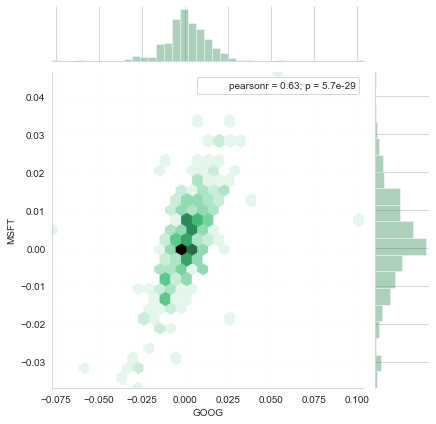

In [30]:
# plotting the joint plot between Google and Microsoft
filterwarnings('ignore')
sns.jointplot(x = 'GOOG', 
              y = 'MSFT', 
              data = tech_returns, 
              kind = 'hex', 
              color = 'seagreen').annotate(stats.pearsonr)
plt.show()

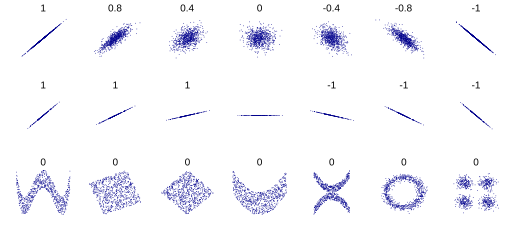

In [31]:
# illustrations of Pearson Product-Moment Correlation Coefficient
from IPython.display import SVG
SVG(url = 'http://upload.wikimedia.org/wikipedia/commons/d/d4/Correlation_examples2.svg')

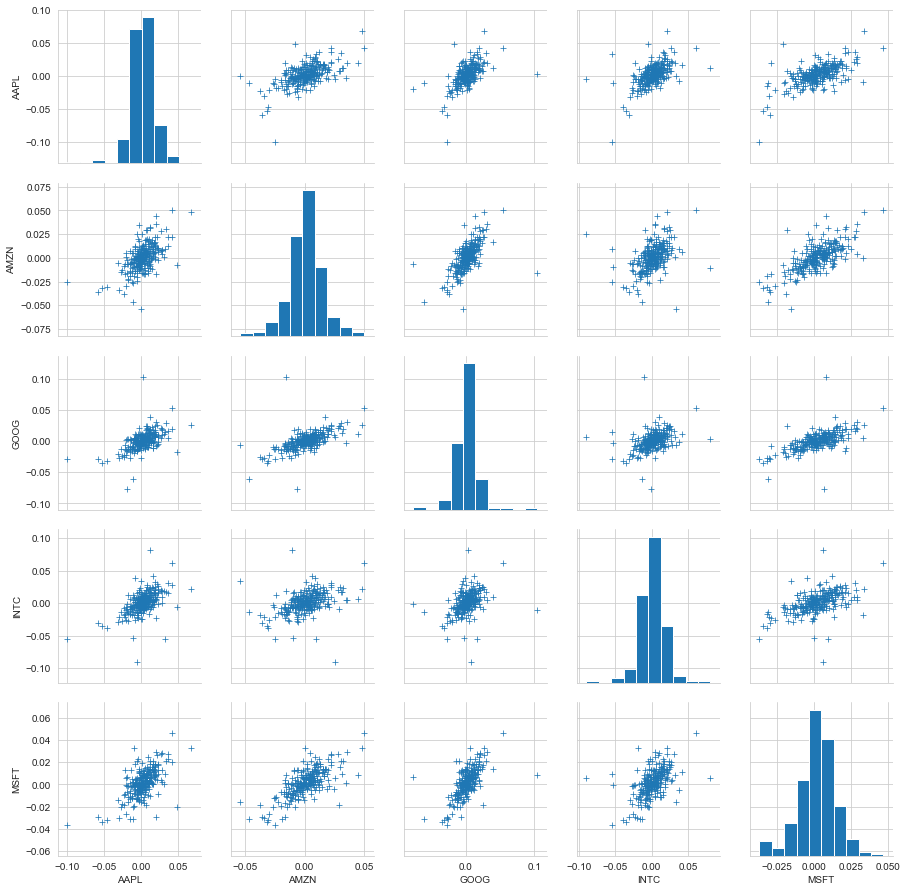

In [32]:
# pairplot of correlation among technology companies for daily returns
sns.pairplot(tech_returns.dropna(), markers = '+')

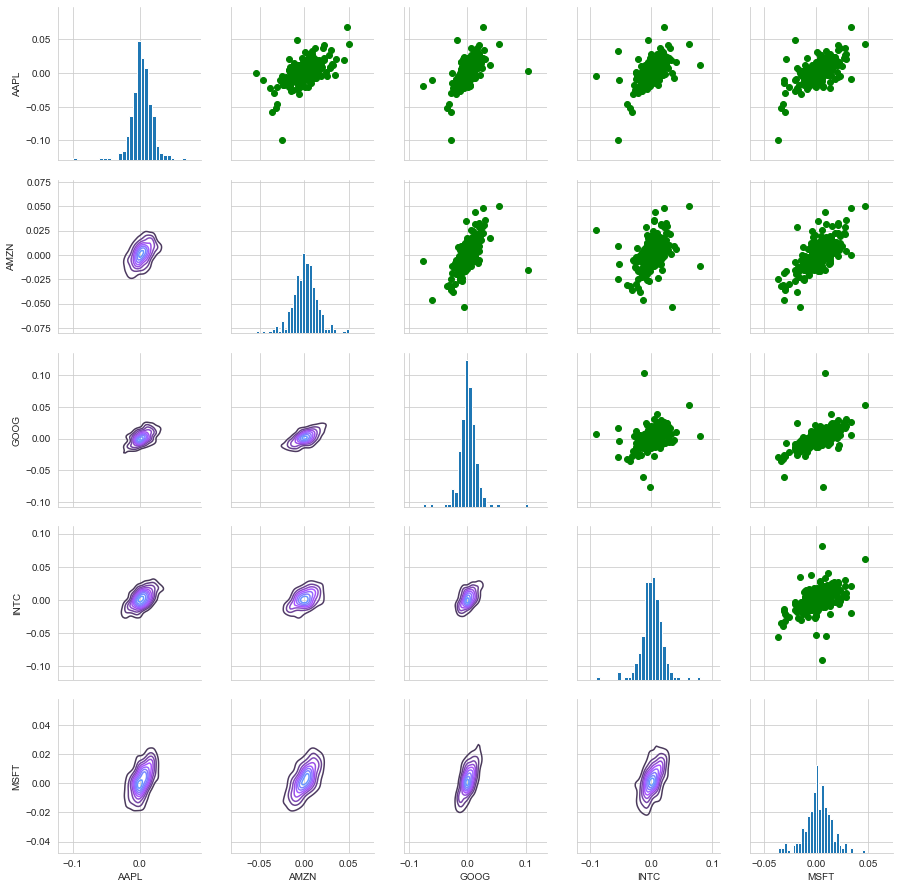

In [33]:
# modifying the previous plot
returns_fig = sns.PairGrid(tech_returns.dropna())

returns_fig.map_upper(plt.scatter, color = 'green')

returns_fig.map_lower(sns.kdeplot, cmap = 'cool_d')

returns_fig.map_diag(plt.hist, bins = 30)

Symbols      AAPL      AMZN      GOOG      INTC      MSFT
Symbols                                                  
AAPL     1.000000  0.589030  0.557748  0.551404  0.621763
AMZN     0.589030  1.000000  0.609746  0.396186  0.715465
GOOG     0.557748  0.609746  1.000000  0.377940  0.627280
INTC     0.551404  0.396186  0.377940  1.000000  0.515528
MSFT     0.621763  0.715465  0.627280  0.515528  1.000000


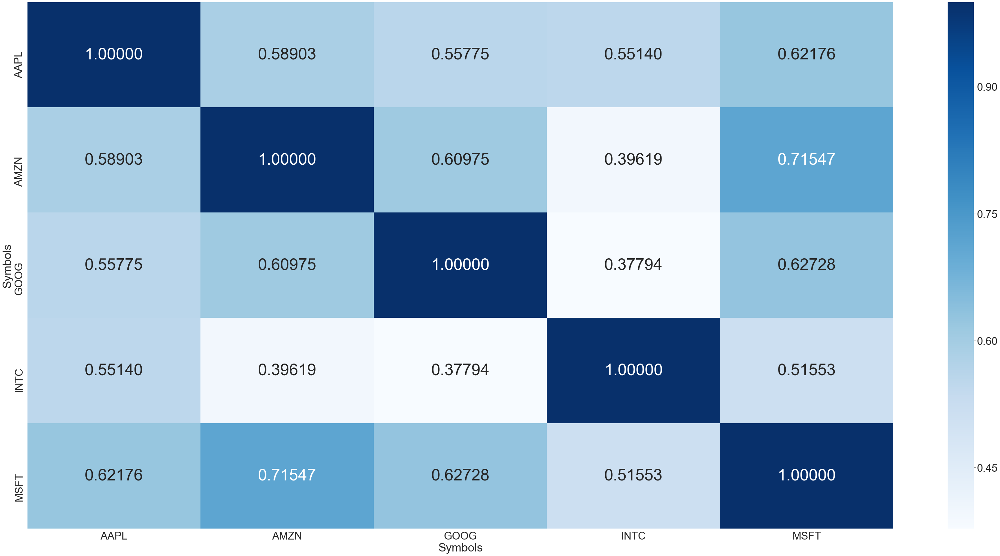

In [34]:
# correlation plot and correlation matrix for daily return 
rets_corr = tech_returns.corr()
print(rets_corr)

tech_rets_corr= tech_returns.dropna().corr()
sns.set(font_scale = 3)
sns.heatmap(tech_rets_corr, annot=True, annot_kws={"size": 50}, fmt='.5f', cmap = 'Blues')
plt.show()

### What was the correlation between different stocks' closing prices?

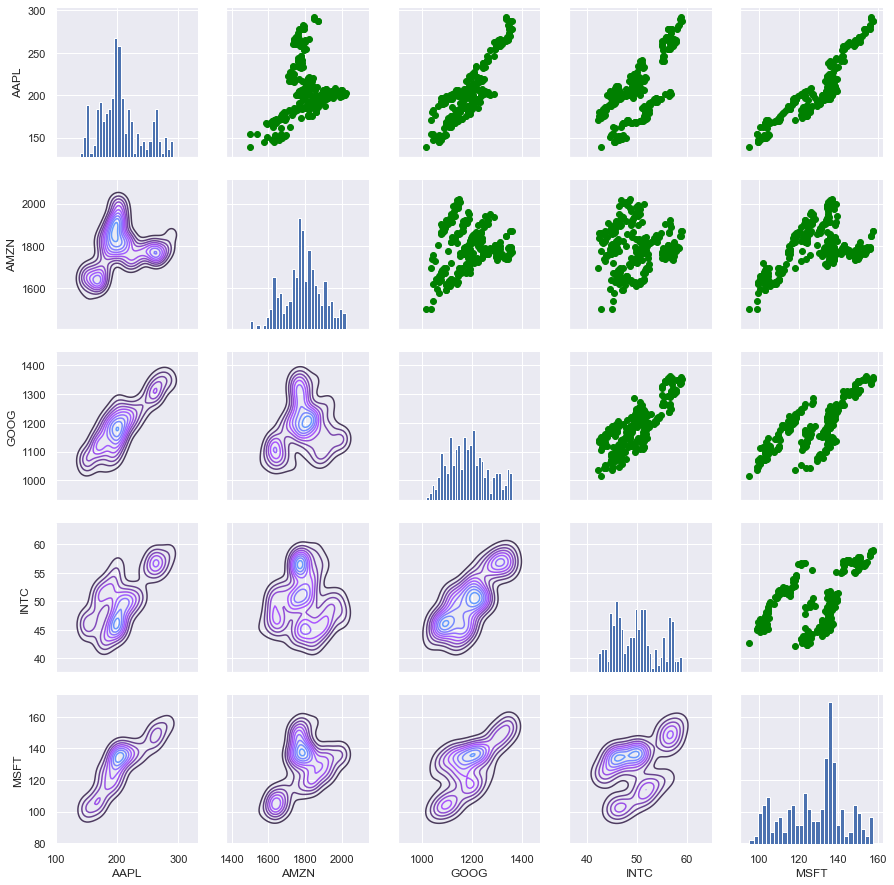

In [35]:
# pairplot of correlation among technology companies for closing prices
sns.set(font_scale = 1)
returns_fig = sns.PairGrid(closing.dropna())

returns_fig.map_upper(plt.scatter, color = 'green')

returns_fig.map_lower(sns.kdeplot, cmap = 'cool_d')

returns_fig.map_diag(plt.hist, bins = 30)

Symbols      AAPL      AMZN      GOOG      INTC      MSFT
Symbols                                                  
AAPL     1.000000  0.287897  0.898406  0.720990  0.919007
AMZN     0.287897  1.000000  0.192592  0.029794  0.508415
GOOG     0.898406  0.192592  1.000000  0.831241  0.746929
INTC     0.720990  0.029794  0.831241  1.000000  0.467773
MSFT     0.919007  0.508415  0.746929  0.467773  1.000000


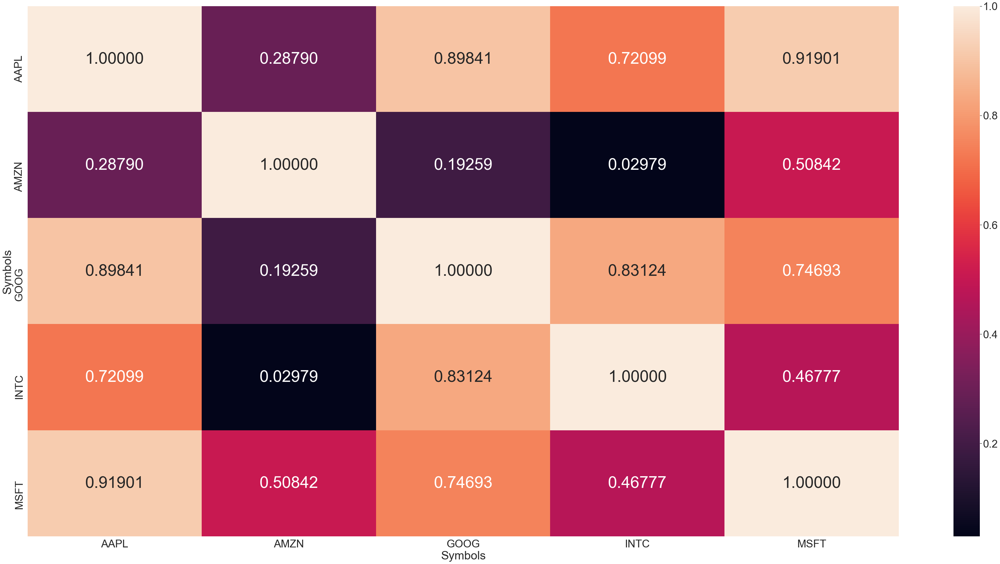

In [36]:
# correlation plot and correlation matrix for closing prices
close_corr = closing.corr()
print(close_corr)

close_corr= closing.dropna().corr()
sns.set(font_scale = 3)
sns.heatmap(close_corr, annot=True, annot_kws={"size": 50}, fmt='.5f')
plt.show()

### How much value do we put at risk in a particular stock?

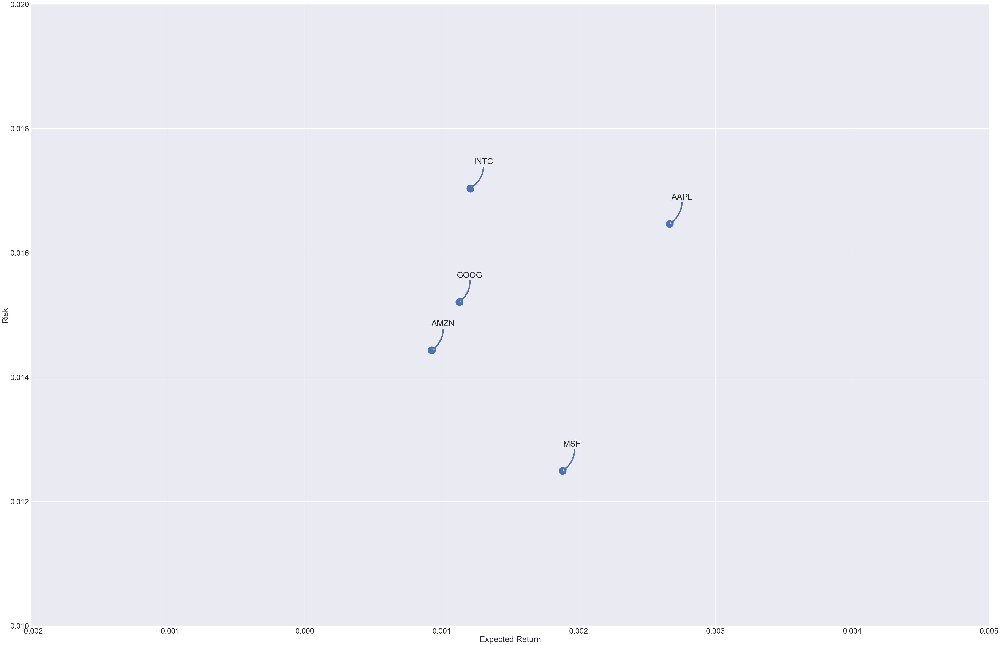

In [56]:
# drop NaN value from return columns
rets = tech_returns.dropna()

# set the size of points
area = np.pi*350

# scatter plot and labeling
plt.scatter(rets.mean(), rets.std(), s = area)
plt.xlabel('Expected Return')
plt.ylabel('Risk')
plt.xlim(-0.002, 0.005)
plt.ylim(0.010, 0.020)

# annotation
for label, x, y in zip(rets.columns, rets.mean(), rets.std()):
    plt.annotate(
        label, 
        xy = (x, y), 
        xytext = (100, 100), 
        textcoords = 'offset points', 
        ha = 'right',
        va = 'bottom',
        arrowprops = dict(
            arrowstyle = 'simple',
            connectionstyle = 'arc3, rad = -0.3'
        )
    )

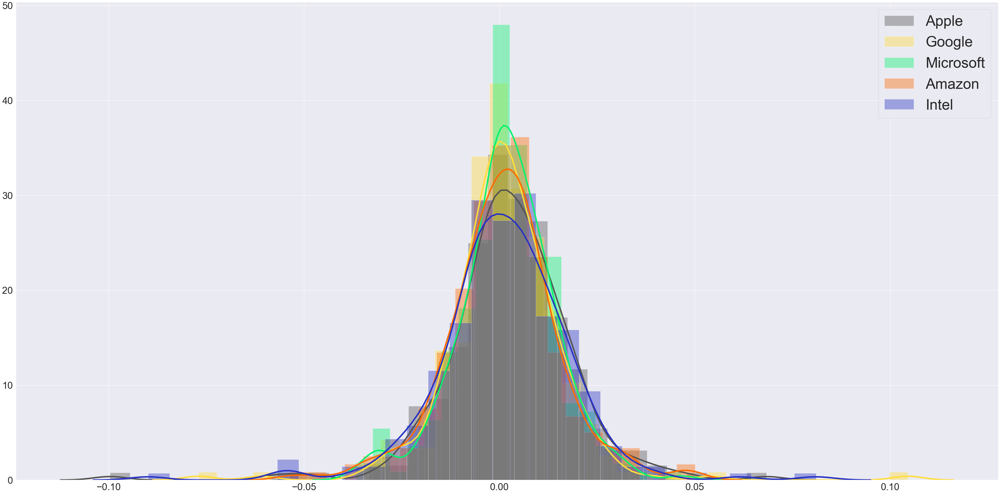

In [38]:
# distribution plot of each company's daily return

sns.distplot(
    AAPL[['Daily Return']].dropna(), 
    hist = True,
    kde = True,
    kde_kws = {'linewidth': 5
              }, 
    color = '#555555',
    label = 'Apple'
)
sns.distplot(
    GOOG[['Daily Return']].dropna(), 
    hist = True,
    kde = True,
    kde_kws = {'linewidth': 5
              },
    color = '#FFDD3C',
    label = 'Google'
)
sns.distplot(
    MSFT[['Daily Return']].dropna(), 
    hist = True,
    kde = True,
    kde_kws = {'linewidth': 5
              },
    color = '#08F26E',
    label = 'Microsoft'
)
sns.distplot(
    AMZN[['Daily Return']].dropna(),               
    hist = True,
    kde = True,
    kde_kws = {'linewidth': 5
              },
    color = '#FD6A02', 
    label = 'Amazon'
)
sns.distplot(
    INTC[['Daily Return']].dropna(),                
    hist = True,
    kde = True,
    kde_kws = {'linewidth': 5
              },
    color = '#2832C2',
    label = 'Intel'
)

plt.legend(prop={'size': 50})
plt.rcParams["figure.figsize"] = (75,50)


#### Bootstrap Method
This method will calculate the empirical quantiles from a histogram of daily returns.
Source: http://en.wikipedia.org/wiki/Quantile

In [39]:
rets.head()

Symbols,AAPL,AMZN,GOOG,INTC,MSFT
Date,,,,,
2019-01-02,0.001141,0.024741,0.009888,0.003196,-0.004430
2019-01-03,-0.099607,-0.025242,-0.028484,-0.055013,-0.036788
2019-01-04,0.042689,0.050064,0.053786,0.061362,0.046509
2019-01-07,-0.002226,0.034353,-0.002167,0.004659,0.001275
2019-01-08,0.019063,0.016612,0.007385,0.006324,0.007251


In [40]:
# applying bootstrap method 
AAPL_rets = rets['AAPL'].quantile(0.05)
GOOG_rets = rets['GOOG'].quantile(0.05)
MSFT_rets = rets['MSFT'].quantile(0.05)
AMZN_rets = rets['AMZN'].quantile(0.05)
INTC_rets = rets['INTC'].quantile(0.05)

techs = pd.DataFrame(['Apple', 'Google', 'Microsoft', 'Amazon', 'Intel'], columns = ['techs'])

boots_rets = pd.DataFrame([AAPL_rets, GOOG_rets, MSFT_rets, AMZN_rets, INTC_rets], columns = ['boots_rets'])


rets_df = pd.concat([techs, boots_rets], axis = 1)
rets_df

for index, row in rets_df.iterrows():
    print('95% of the times of simulations, the worst daily loss in investing on ' + 
          str(row['techs']) + 
          ' would not exceed ' + 
          str(100 * abs(row['boots_rets'])) + 
          '%\n----------------------------------------------------------------------------------------------------------------'
         )

95% of the times for simulations, the worst daily loss in investing on Apple would not exceed 2.0656410764138453%
----------------------------------------------------------------------------------------------------------------
95% of the times for simulations, the worst daily loss in investing on Google would not exceed 2.0611497183996246%
----------------------------------------------------------------------------------------------------------------
95% of the times for simulations, the worst daily loss in investing on Microsoft would not exceed 1.9141555233772998%
----------------------------------------------------------------------------------------------------------------
95% of the times for simulations, the worst daily loss in investing on Amazon would not exceed 2.3186321935004957%
----------------------------------------------------------------------------------------------------------------
95% of the times for simulations, the worst daily loss in investing on Intel would not

### How can we attempt to predict future stock behavior?

#### Monte-Carlo Simulation
The **Geometric Brownian Motion** (**GBM**)/ **Markov Procecss** is going to be used. This means that the stock price follows a random walk and is consistent with (at the very least) the weak form of the **Efficient Market Hypothesis** (**EMH**): past price information is already incorporated and the next price movement is "conditionally independent" of the past price movement. 

In other words, the past information on the price of the stock is independent of where the stock price will be in the future, basically meaning, you can not perfectly predict the future solely based on the previous price of a stock.

The equation for geometric Browninan motion is given by the following equation:

$$\frac{ΔS}{S}=μΔt+σϵ\sqrt{Δt}$$

Where S is the stock price, mu is the expected return (which we calculated earlier), sigma is the standard deviation of the returns, t is time, and epsilon is the random variable.

We can multiply both sides by the stock price (S) to rearrange the formula and solve for the stock price.

$$ΔS=S(μΔt+σϵ\sqrt{Δt})$$

Now we see that the change in the stock price is the current stock price multiplied by two terms. The first term is known as "**drift**", which is the average daily return multiplied by the change of time. The second term is known as "**shock**", for each time period the stock will "drift" and then experience a "shock" which will randomly push the stock price up or down. By simulating this series of steps of drift and shock thousands of times, we can begin to do a simulation of where we might expect the stock price to be.

Source: http://www.investopedia.com/articles/07/montecarlo.asp

In [41]:
# setting up the necessary initial variables
days = 365
dt = 1 / days

AAPL_mu = rets.mean()['AAPL']
AAPL_sigma = rets.std()['AAPL']

GOOG_mu = rets.mean()['GOOG']
GOOG_sigma = rets.std()['GOOG']

MSFT_mu = rets.mean()['MSFT']
MSFT_sigma = rets.std()['MSFT']

AMZN_mu = rets.mean()['AMZN']
AMZN_sigma = rets.std()['AMZN']

INTC_mu = rets.mean()['INTC']
INTC_sigma = rets.std()['INTC']

In [42]:
# running Monte-Carlo simulation
def stock_monte_carlo(start_price, days, mu, sigma):
    price = np.zeros(days)
    price[0] = start_price
    
    shock = np.zeros(days)
    drift = np.zeros(days)
    
    for x in range(1, days):
        shock[x] = np.random.normal(loc = mu * dt, 
                                    scale = sigma * np.sqrt(dt)
                                   )
        drift[x] = mu * dt
        price[x] = price[x - 1] + (price[x - 1] * (drift[x] + shock[x]))
    return price

Text(0.5, 1.0, 'Monte-Carlo Simulation for Apple')

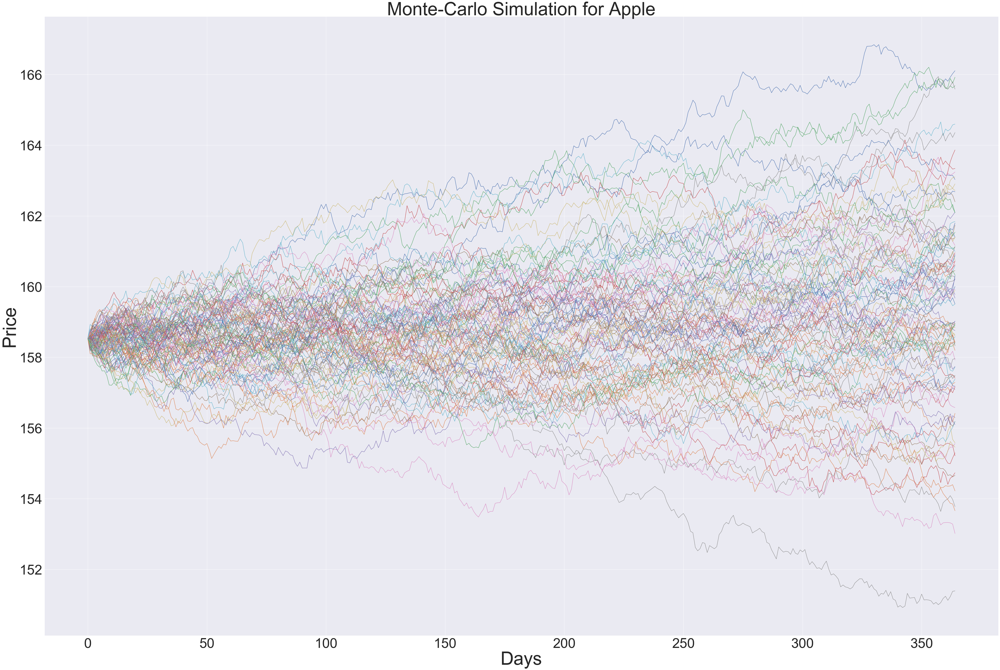

In [43]:
# 100 simulations for Apple
AAPL_start_price = AAPL['Open'][0]

for run in range(100):
    AAPL_simulation = stock_monte_carlo(AAPL_start_price, days, AAPL_mu, AAPL_sigma)
    plt.plot(AAPL_simulation)

plt.xlabel('Days', size = 80)
plt.xticks(fontsize = 60)
plt.ylabel('Price', size = 80)
plt.yticks(fontsize = 60)
plt.title('Monte-Carlo Simulation for Apple', size = 80)

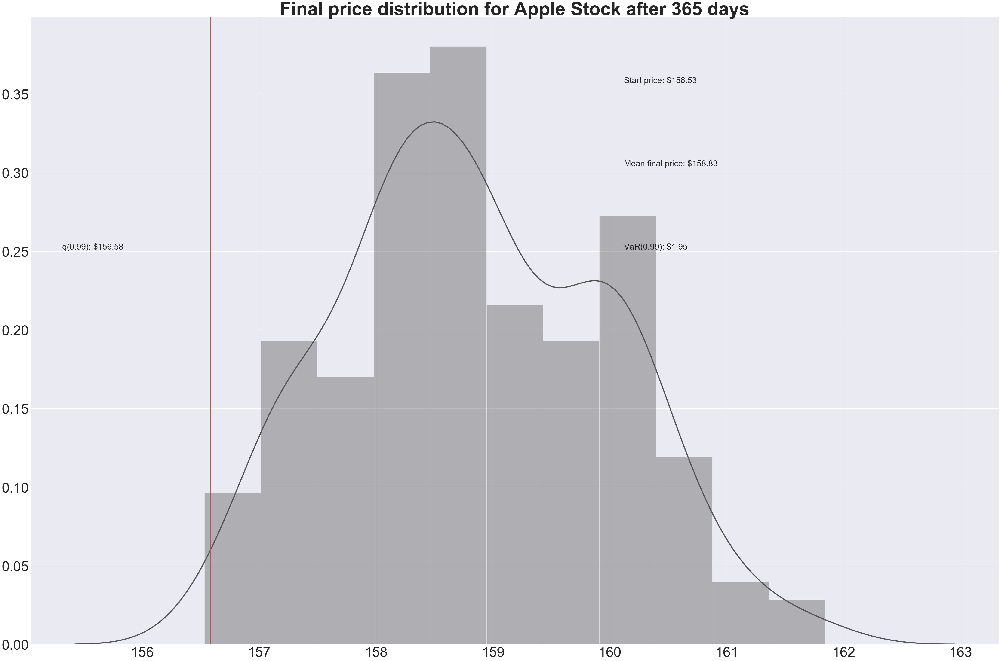

In [44]:
q = np.percentile(AAPL_simulation, 1)
sns.distplot(
    AAPL_simulation, 
    kde_kws = {'linewidth': 5}, 
    color = '#555555')

# starting price
plt.figtext(0.6, 0.8,s="Start price: $%.2f" %AAPL_start_price)
# mean ending price
plt.figtext(0.6, 0.7, "Mean final price: $%.2f" % AAPL_simulation.mean())

# variance of the price (within 99% confidence interval)
plt.figtext(0.6, 0.6, "VaR(0.99): $%.2f" % (AAPL_start_price - q,))

# display 1% quantile
plt.figtext(0.15, 0.6, "q(0.99): $%.2f" % q)

# plot a line at the 1% quantile result
plt.axvline(x=q, linewidth=4, color='r')

# title
plt.xticks(fontsize = 60)
plt.yticks(fontsize = 60)
plt.title(u"Final price distribution for Apple Stock after %s days" % days, weight='bold', size = 80);

Text(0.5, 1.0, 'Monte-Carlo Simulation for Google')

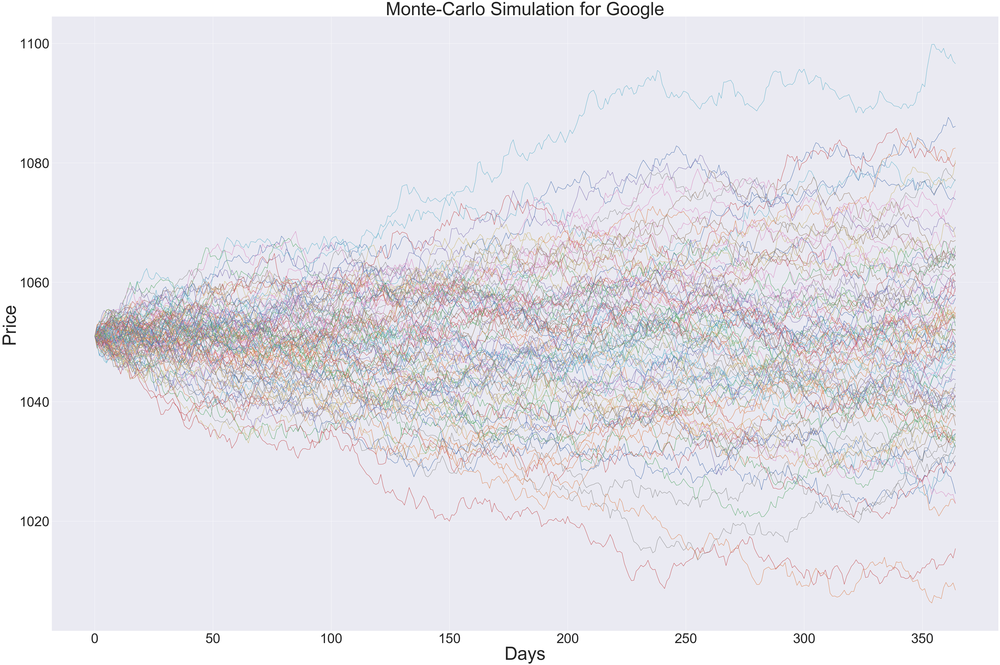

In [45]:
# 100 simulations for Google
GOOG_start_price = GOOG['Open'][0]

for run in range(100):
    GOOG_simulation = stock_monte_carlo(GOOG_start_price, days, GOOG_mu, GOOG_sigma)
    plt.plot(GOOG_simulation)

plt.xlabel('Days', size = 80)
plt.xticks(fontsize = 60)
plt.ylabel('Price', size = 80)
plt.yticks(fontsize = 60)
plt.title('Monte-Carlo Simulation for Google', size = 80)

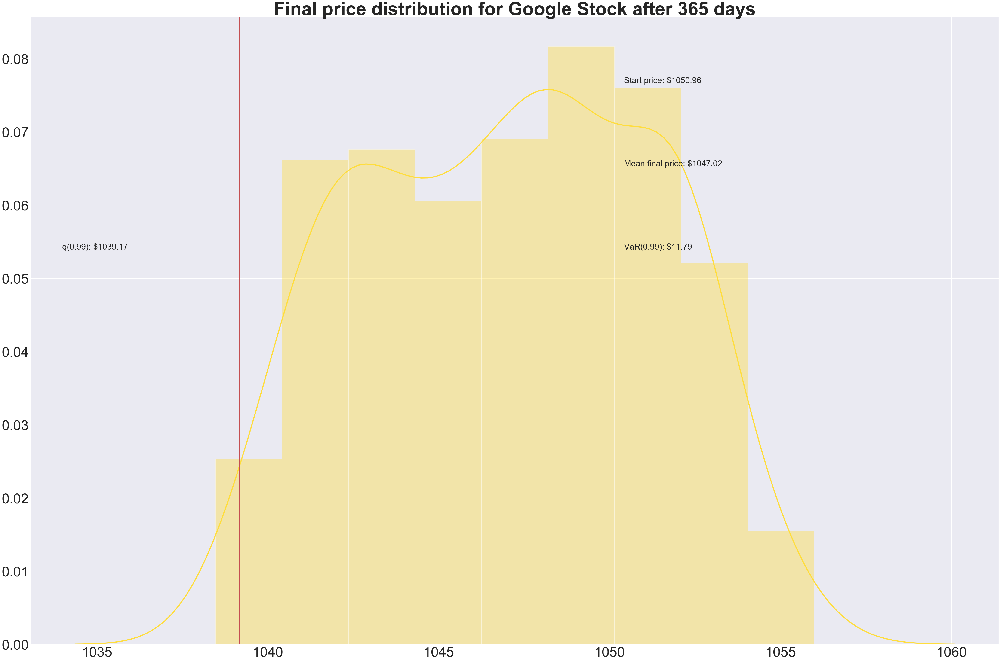

In [46]:
q = np.percentile(GOOG_simulation, 1)
sns.distplot(
    GOOG_simulation, 
    kde_kws = {'linewidth': 5},
    color = '#FFDD3C')

# starting price
plt.figtext(0.6, 0.8,s="Start price: $%.2f" %GOOG_start_price)
# mean ending price
plt.figtext(0.6, 0.7, "Mean final price: $%.2f" % GOOG_simulation.mean())

# variance of the price (within 99% confidence interval)
plt.figtext(0.6, 0.6, "VaR(0.99): $%.2f" % (GOOG_start_price - q,))

# display 1% quantile
plt.figtext(0.15, 0.6, "q(0.99): $%.2f" % q)

# plot a line at the 1% quantile result
plt.axvline(x=q, linewidth=4, color='r')

# title
plt.xticks(fontsize = 60)
plt.yticks(fontsize = 60)
plt.title(u"Final price distribution for Google Stock after %s days" % days, weight='bold', size = 80);

Text(0.5, 1.0, 'Monte-Carlo Simulation for Microsoft')

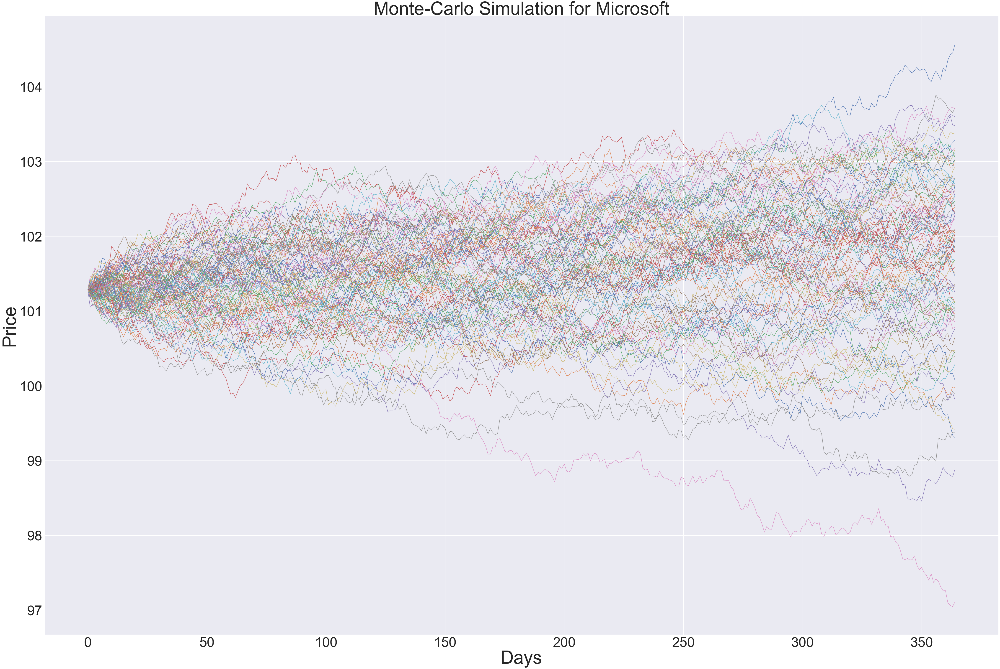

In [47]:
# 100 simulations for Microsoft
MSFT_start_price = MSFT['Open'][0]

for run in range(100):
    MSFT_simulation = stock_monte_carlo(MSFT_start_price, days, MSFT_mu, MSFT_sigma)
    plt.plot(MSFT_simulation)

plt.xlabel('Days', size = 80)
plt.xticks(fontsize = 60)
plt.ylabel('Price', size = 80)
plt.yticks(fontsize = 60)
plt.title('Monte-Carlo Simulation for Microsoft', size = 80)

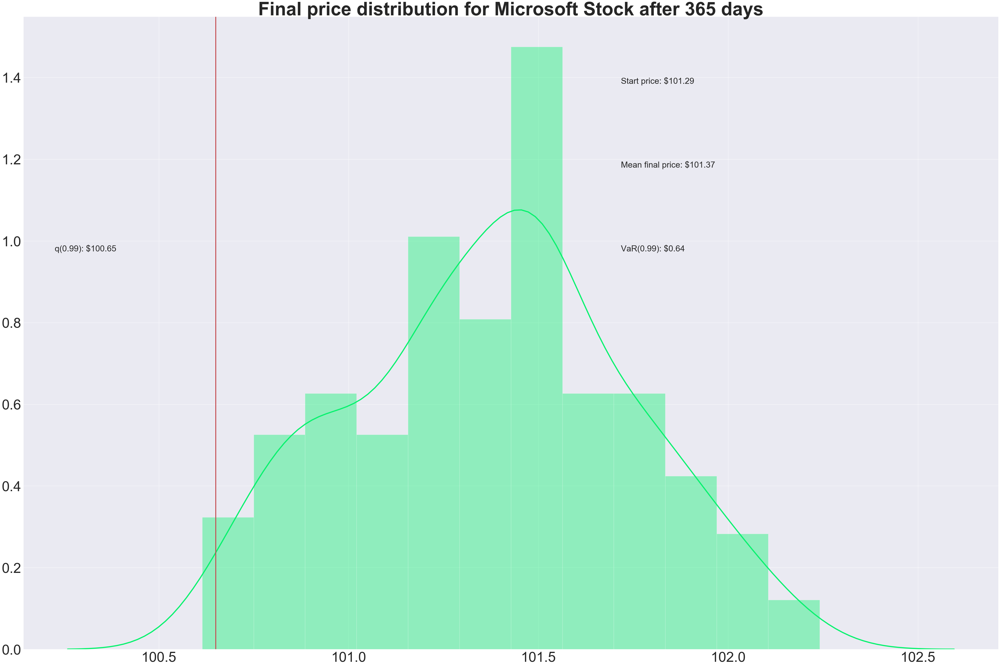

In [48]:
q = np.percentile(MSFT_simulation, 1)
sns.distplot(
    MSFT_simulation, 
    kde_kws = {'linewidth': 5},
    color = '#08F26E')

# starting price
plt.figtext(0.6, 0.8,s="Start price: $%.2f" %MSFT_start_price)
# mean ending price
plt.figtext(0.6, 0.7, "Mean final price: $%.2f" % MSFT_simulation.mean())

# variance of the price (within 99% confidence interval)
plt.figtext(0.6, 0.6, "VaR(0.99): $%.2f" % (MSFT_start_price - q,))

# display 1% quantile
plt.figtext(0.15, 0.6, "q(0.99): $%.2f" % q)

# plot a line at the 1% quantile result
plt.axvline(x=q, linewidth=4, color='r')

# title
plt.xticks(fontsize = 60)
plt.yticks(fontsize = 60)
plt.title(u"Final price distribution for Microsoft Stock after %s days" % days, weight='bold', size = 80);

Text(0.5, 1.0, 'Monte-Carlo Simulation for Amazon')

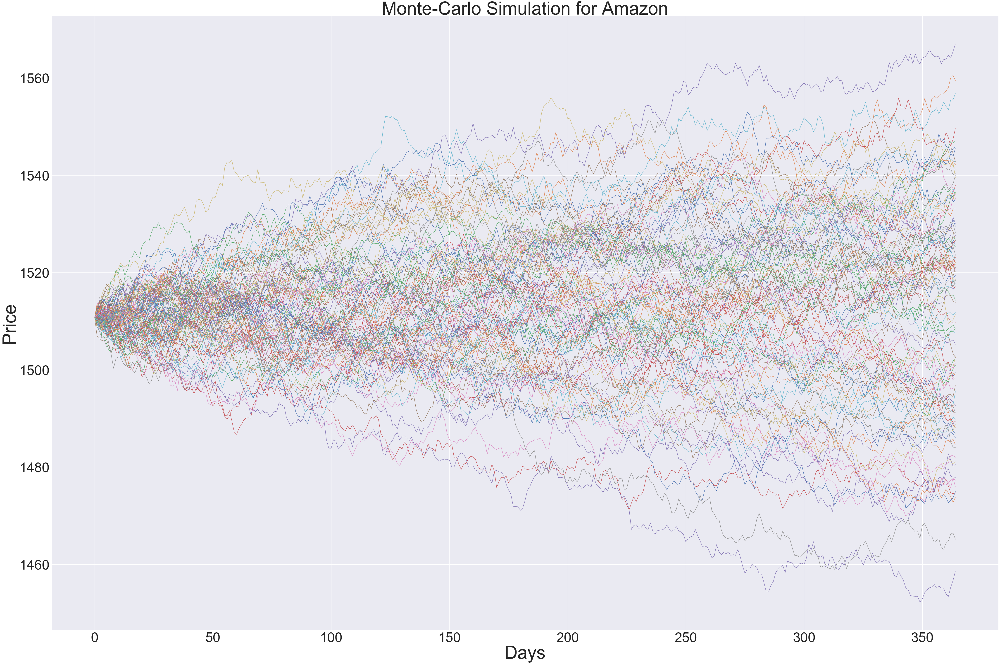

In [49]:
# 100 simulations for Amazon
AMZN_start_price = AMZN['Open'][0]

for run in range(100):
    AMZN_simulation = stock_monte_carlo(AMZN_start_price, days, AMZN_mu, AMZN_sigma)
    plt.plot(AMZN_simulation)

plt.xlabel('Days', size = 80)
plt.xticks(fontsize = 60)
plt.ylabel('Price', size = 80)
plt.yticks(fontsize = 60)
plt.title('Monte-Carlo Simulation for Amazon', size = 80)

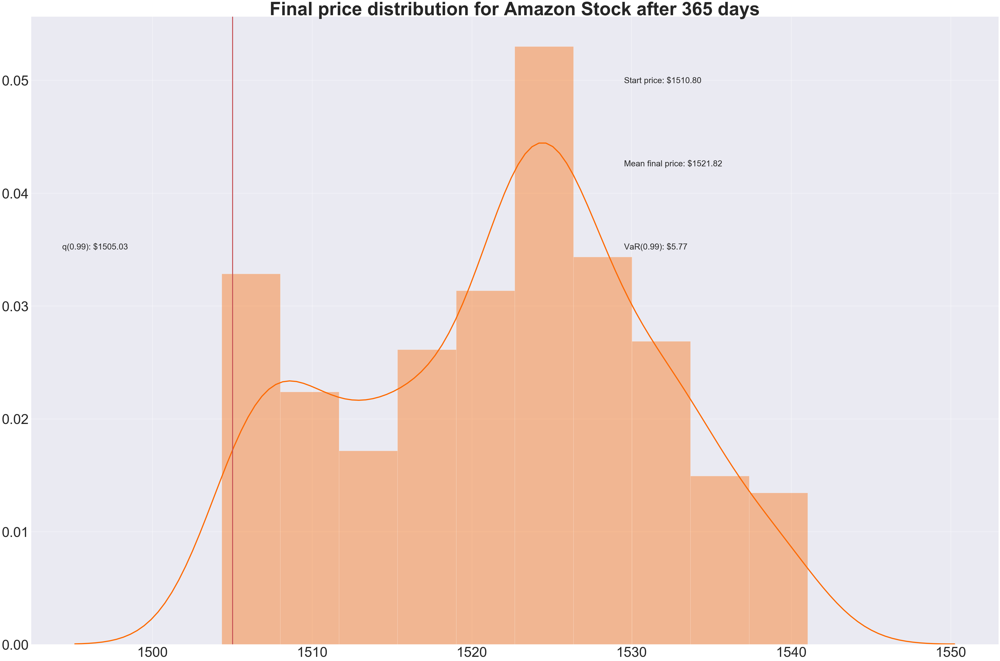

In [50]:
q = np.percentile(AMZN_simulation, 1)
sns.distplot(
    AMZN_simulation,
    kde_kws = {'linewidth': 5},
    color = '#FD6A02')

# starting price
plt.figtext(0.6, 0.8,s="Start price: $%.2f" %AMZN_start_price)
# mean ending price
plt.figtext(0.6, 0.7, "Mean final price: $%.2f" % AMZN_simulation.mean())

# variance of the price (within 99% confidence interval)
plt.figtext(0.6, 0.6, "VaR(0.99): $%.2f" % (AMZN_start_price - q,))

# display 1% quantile
plt.figtext(0.15, 0.6, "q(0.99): $%.2f" % q)

# plot a line at the 1% quantile result
plt.axvline(x=q, linewidth=4, color='r')

# title
plt.xticks(fontsize = 60)
plt.yticks(fontsize = 60)
plt.title(u"Final price distribution for Amazon Stock after %s days" % days, weight='bold', size = 80);

Text(0.5, 1.0, 'Monte-Carlo Simulation for Intel')

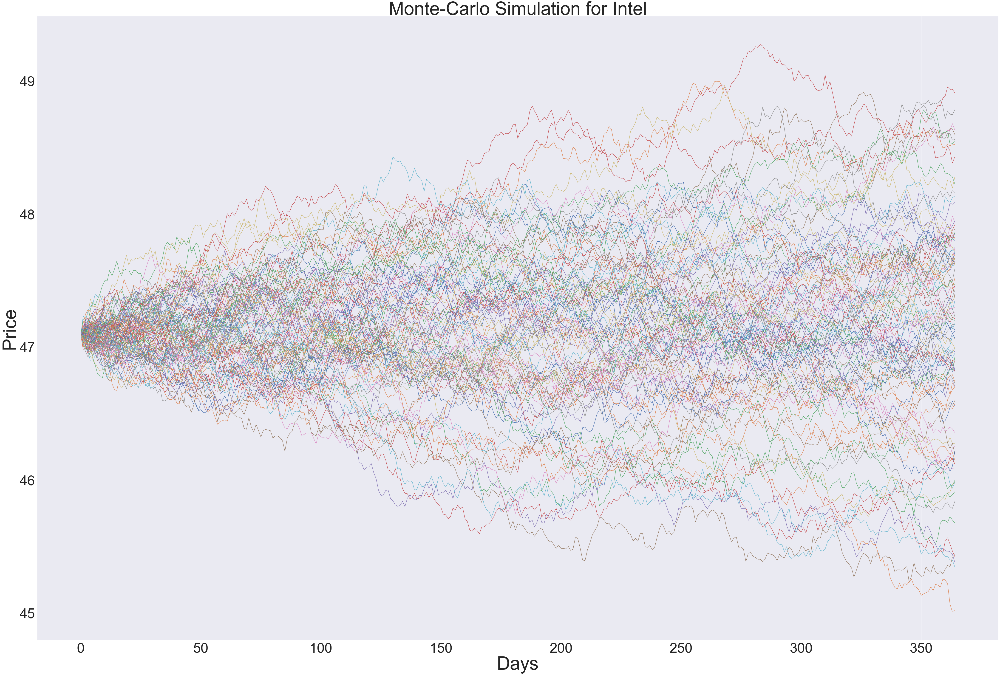

In [51]:
# 100 simulations for Intel
INTC_start_price = INTC['Open'][0]

for run in range(100):
    INTC_simulation = stock_monte_carlo(INTC_start_price, days, INTC_mu, INTC_sigma)
    plt.plot(INTC_simulation)

plt.xlabel('Days', size = 80)
plt.xticks(fontsize = 60)
plt.ylabel('Price', size = 80)
plt.yticks(fontsize = 60)
plt.title('Monte-Carlo Simulation for Intel', size = 80)

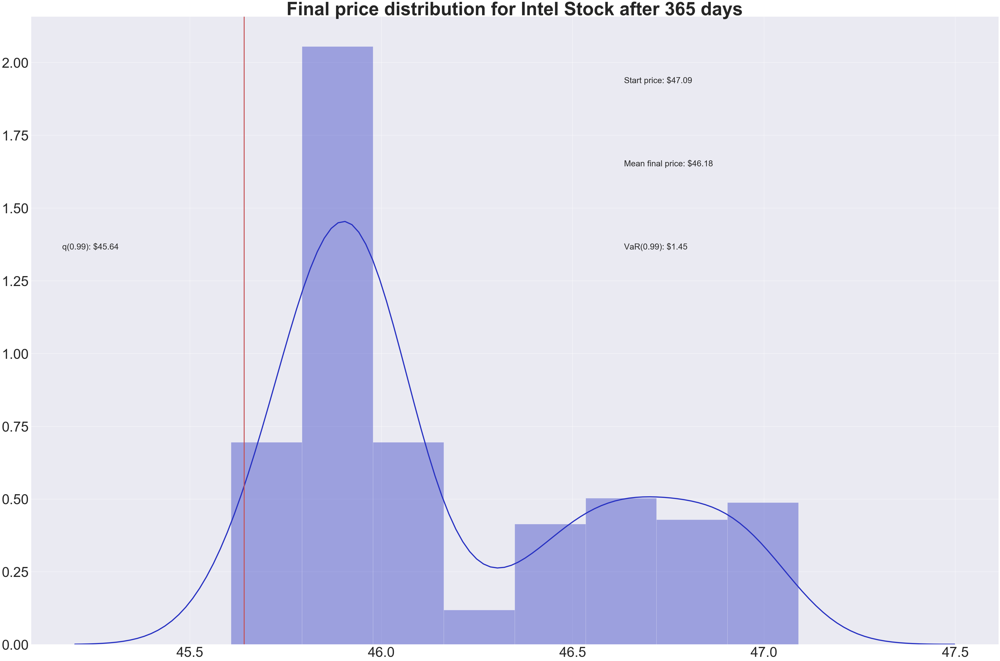

In [52]:
q = np.percentile(INTC_simulation, 1)
sns.distplot(
    INTC_simulation,
    kde_kws = {'linewidth': 5},
    color = '#2832C2')

# starting price
plt.figtext(0.6, 0.8,s="Start price: $%.2f" %INTC_start_price)
# mean ending price
plt.figtext(0.6, 0.7, "Mean final price: $%.2f" % INTC_simulation.mean())

# variance of the price (within 99% confidence interval)
plt.figtext(0.6, 0.6, "VaR(0.99): $%.2f" % (INTC_start_price - q,))

# display 1% quantile
plt.figtext(0.15, 0.6, "q(0.99): $%.2f" % q)

# plot a line at the 1% quantile result
plt.axvline(x=q, linewidth=4, color='r')

# title
plt.xticks(fontsize = 60)
plt.yticks(fontsize = 60)
plt.title(u"Final price distribution for Intel Stock after %s days" % days, weight='bold', size = 80);